In [1]:
import numpy as np
import pandas as pd
import os
from datetime import date
from matplotlib import pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import csv
import plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from jupyter_dash import JupyterDash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
import datetime

In [54]:
map_token='pk.eyJ1IjoiZnJhbmNpZ2plY2kiLCJhIjoiY2tpazZveWhmMDZ5MzMxcWp4bzIxbm0wYyJ9.J_qWOJqADI6tZfle2bbZFg'

# Import data

### Traffic Data

In [2]:
# PUT YOUR OWN FILE PATH!
file_path = '../Data' 
file_path = '/home/antlab/data/TrafficCovid_ProjectRedondi'

#  File name 
file_name = 'LTE_1800_Milano.pkl'
file_name = 'LTE_1800_Milano_P2.pkl'


# KPIs
data = pd.read_pickle(os.path.join(file_path, file_name))

In [3]:
data.head(1)

,REGIONE,COMUNE,LONG_X,LAT_Y,Date,ECELL_ID,DL_BW,RRC_S_Succ,RRC_S_Att,RRC_S_SR,...,DL_VOL,UL_VOL,DL_THR_AVG,UL_THR_AVG,DL_THR_MAX,UL_THR_MAX,USERNUM_AVG,USERNUM_MAX,PRB_DL_Used_Avg,PRB_UL_Used_Avg
0,LOMBARDIA,MILANO,9.19063854217529,45.4812240600586,2020-04-01 05:00:00,1584c220e0dc1b3,20.0,205.0,205.0,100.0,...,57480.0,1072.0,2.5,3.0,11.0,15.0,0.356667,1.0,0.035,0.0


In [4]:
# Take partial set of data
# df_traffic = data[data['COMUNE'] == 'MILANO']
df_traffic = data

In [5]:
df_traffic.shape

(2660145, 42)

### Covid Data - Provincia

In [6]:
# Source: Github - Certified by italian authorities
# path = 'https://github.com/pcm-dpc/COVID-19/blob/master/dati-province/dpc-covid19-ita-province.csv'
# Seen the data and corrected them to not waste any line
path = '../Data/dpc-covid19-ita-province.csv'

In [7]:
#path = 'https://github.com/pcm-dpc/COVID-19/blob/master/dati-regioni/dpc-covid19-ita-regioni.csv'
#with open(path, 'r') as f:
#        print("This is the line.")
#        print(next(itertools.islice(csv.reader(f), N, None)))

In [8]:
columns = ['data','stato','codice_regione','denominazione_regione','codice_provincia',
           'denominazione_provincia','sigla_provincia','lat','long','totale_casi','note']
df_covid = pd.read_csv(path,   quotechar="'",  skiprows = 1,
                       #sep=',\s*',quoting=csv.QUOTE_NONE,
                       #skipinitialspace=True,# sep=',', engine='python',
                       #encoding="utf-8", sep=',\s*',quoting=csv.QUOTE_NONE,
                      names = columns
                      )

In [9]:
df_covid.iloc[16816:16820]

,data,stato,codice_regione,denominazione_regione,codice_provincia,denominazione_provincia,sigla_provincia,lat,long,totale_casi,note
16816,"""2020-07-03T17:00:00",ITA,17,Basilicata,880,Fuori Regione / Provincia Autonoma,NaN,NaN,NaN,4,"""""NEL TOTALE CASI POSITIVI SONO COMPRESI ULTER..."
16817,2020-07-03T17:00:00,ITA,17,Basilicata,980,In fase di definizione/aggiornamento,NaN,NaN,NaN,0,NaN
16818,2020-07-03T17:00:00,ITA,18,Calabria,78,Cosenza,CS,39.293087,16.256097,468,NaN
16819,2020-07-03T17:00:00,ITA,18,Calabria,79,Catanzaro,CZ,38.905976,16.594402,214,NaN


In [10]:
df_covid['data'] = df_covid['data'].str.replace('"', '')

In [11]:
df_covid.iloc[16817]['data']

'2020-07-03T17:00:00'

In [12]:
df_covid.head(1)

,data,stato,codice_regione,denominazione_regione,codice_provincia,denominazione_provincia,sigla_provincia,lat,long,totale_casi,note
0,2020-02-24T18:00:00,ITA,13,Abruzzo,66,L'Aquila,AQ,42.351222,13.398438,0,NaN


### Covid Data - Regione

In [13]:
path = '../Data/dpc-covid19-ita-regioni.csv'
df_covid_region = pd.read_csv(path)

In [14]:
df_covid_region.iloc[1]

data                            2020-02-24T18:00:00
stato                                           ITA
codice_regione                                   17
denominazione_regione                    Basilicata
lat                                         40.6395
long                                        15.8051
ricoverati_con_sintomi                            0
terapia_intensiva                                 0
totale_ospedalizzati                              0
isolamento_domiciliare                            0
totale_positivi                                   0
variazione_totale_positivi                        0
nuovi_positivi                                    0
dimessi_guariti                                   0
deceduti                                          0
casi_da_sospetto_diagnostico                    NaN
casi_da_screening                               NaN
totale_casi                                       0
tamponi                                           0
casi_testati

## Set Data Type

### Traffic Data

In [15]:
df_traffic['Date'] = pd.to_datetime(df_traffic['Date'], format='%Y-%m-%d %H:%M:%S')

In [16]:
df_traffic.loc[df_traffic['LONG_X']=='[null]', 'LONG_X' ] = ''
df_traffic.loc[df_traffic['LAT_Y']=='[null]', 'LAT_Y' ] = ''

In [17]:
df_traffic['LONG_X'] =  pd.to_numeric(df_traffic["LONG_X"], downcast="float")
df_traffic['LAT_Y'] =  pd.to_numeric(df_traffic["LAT_Y"], downcast="float")

In [18]:
df_traffic['week'] = df_traffic['Date'].dt.week

### Covid Data

In [19]:
df_covid['data'] = pd.to_datetime(df_covid['data'], format='%Y-%m-%dT%H:%M:%S')
df_covid['totale_casi'] = df_covid['totale_casi'].astype(int)


In [20]:
df_covid.iloc[16816:16820]

,data,stato,codice_regione,denominazione_regione,codice_provincia,denominazione_provincia,sigla_provincia,lat,long,totale_casi,note
16816,2020-07-03 17:00:00,ITA,17,Basilicata,880,Fuori Regione / Provincia Autonoma,NaN,NaN,NaN,4,"""""NEL TOTALE CASI POSITIVI SONO COMPRESI ULTER..."
16817,2020-07-03 17:00:00,ITA,17,Basilicata,980,In fase di definizione/aggiornamento,NaN,NaN,NaN,0,NaN
16818,2020-07-03 17:00:00,ITA,18,Calabria,78,Cosenza,CS,39.293087,16.256097,468,NaN
16819,2020-07-03 17:00:00,ITA,18,Calabria,79,Catanzaro,CZ,38.905976,16.594402,214,NaN


In [21]:
# set(df_covid[df_covid['denominazione_regione'] == 'Basilicata']['denominazione_provincia'])

In [22]:
# set(df_covid['denominazione_provincia'])

# Data Pocess

### Covid

In [23]:
# The data imported from the official github repository of the Italian authorities have accumulated data
# Thus, we extract daily new infections, to use for further analysis

In [24]:
df_covid_daily = pd.DataFrame(df_covid.groupby([ 
                                'denominazione_regione', 'denominazione_provincia', 
                                'sigla_provincia', df_covid['data'].dt.date]).agg({
    'totale_casi': "sum"}).to_records())

In [25]:
df_covid_daily[df_covid_daily['denominazione_regione']!= 'Abruzzo'].head(2)

,denominazione_regione,denominazione_provincia,sigla_provincia,data,totale_casi
1136,Basilicata,Matera,MT,2020-02-24,0
1137,Basilicata,Matera,MT,2020-02-25,0


In [26]:
df_covid_daily['casi_giornalieri'] = df_covid_daily.groupby([
                    'denominazione_regione', 'denominazione_provincia', 
                    'sigla_provincia'])['totale_casi'].diff()

In [27]:
df_covid_daily.loc[df_covid_daily['casi_giornalieri'].isna() ,
                       'casi_giornalieri'] = df_covid_daily['totale_casi']

In [28]:
# df_covid_daily_day.head(20)

# Data Visualization

### Traffic - Temporal Distribution

In [29]:
df_traffic_week = pd.DataFrame(df_traffic.groupby(df_traffic['Date'].dt.week).agg({
    'DL_VOL': "sum", 'UL_VOL': "sum"}).to_records())

In [30]:
#[df_traffic_week['week'] >= 14].shape
df_traffic_week

,Date,DL_VOL,UL_VOL
0,14,3.590867e+12,5.639953e+11
1,15,5.050284e+12,8.028021e+11
2,16,4.839897e+12,7.501246e+11
3,17,4.954605e+12,7.938561e+11
4,18,4.172058e+12,6.660231e+11
5,19,4.552869e+12,7.248326e+11
6,20,4.620617e+12,7.118940e+11
7,21,4.498955e+12,6.821433e+11
8,22,3.914693e+12,6.028409e+11
9,23,4.543523e+12,5.926609e+11


In [31]:
df_traffic.head(1)

,REGIONE,COMUNE,LONG_X,LAT_Y,Date,ECELL_ID,DL_BW,RRC_S_Succ,RRC_S_Att,RRC_S_SR,...,UL_VOL,DL_THR_AVG,UL_THR_AVG,DL_THR_MAX,UL_THR_MAX,USERNUM_AVG,USERNUM_MAX,PRB_DL_Used_Avg,PRB_UL_Used_Avg,week
0,LOMBARDIA,MILANO,9.190639,45.481224,2020-04-01 05:00:00,1584c220e0dc1b3,20.0,205.0,205.0,100.0,...,1072.0,2.5,3.0,11.0,15.0,0.356667,1.0,0.035,0.0,14


In [32]:
df_traffic_day = pd.DataFrame(df_traffic.groupby(by=[df_traffic['Date'].dt.date, 'REGIONE', 'COMUNE']).agg({
    'DL_VOL': "sum", 'UL_VOL': "sum"}).to_records())

In [33]:
df_traffic_day['MA7_DL'] = df_traffic_day['DL_VOL'].rolling(7).mean()
df_traffic_day['MA20_DL'] = df_traffic_day['DL_VOL'].rolling(20).mean()

In [34]:
df_traffic_day.head(3)

,Date,REGIONE,COMUNE,DL_VOL,UL_VOL,MA7_DL,MA20_DL
0,2020-04-01,LOMBARDIA,MILANO,7.316107e+11,1.195597e+11,NaN,NaN
1,2020-04-02,LOMBARDIA,MILANO,7.090085e+11,1.202476e+11,NaN,NaN
2,2020-04-03,LOMBARDIA,MILANO,7.271238e+11,1.211056e+11,NaN,NaN


In [35]:
df_traffic_day['COMUNE'].unique()

array(['MILANO'], dtype=object)

/home/antlab/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



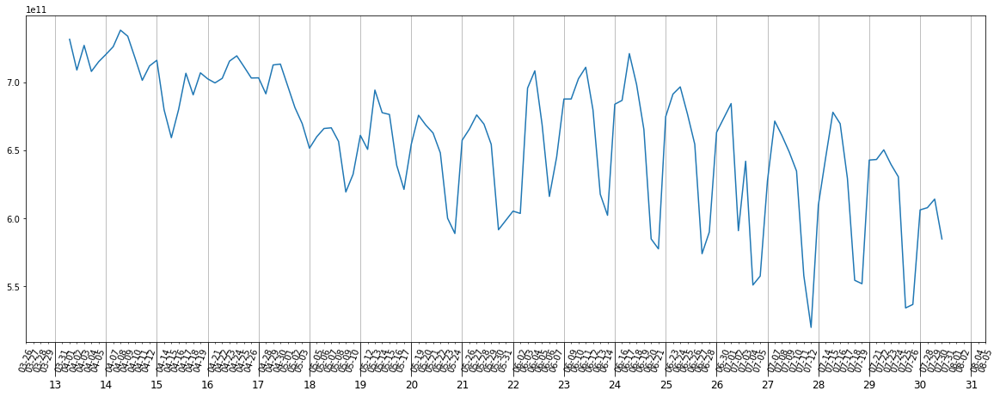

In [36]:
#plot data
fig, ax = plt.subplots(figsize=(20,7))
ax.xaxis.set_major_formatter(DateFormatter('%U'))
ax.xaxis.set_minor_formatter(DateFormatter('%m-%d'))
#ax.xaxis.set_major_locator(mdates.WeekLocator())
ax.xaxis.set_major_locator(mdates.WeekdayLocator(byweekday=mdates.MO))
ax.xaxis.set_minor_locator(mdates.DayLocator())
ax.plot(df_traffic_day['Date'], df_traffic_day[['DL_VOL']])
#df_traffic.groupby(['week'])['DL_VOL'].sum()
# .plot(ax=ax)
# Rotate tick marks on x-axis

plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, fontsize=12)
plt.setp(ax.xaxis.get_minorticklabels(), rotation=70, fontsize=10)

ax.tick_params(axis = 'x', which='major', length=40)
ax.tick_params(axis = 'x', which='minor', length=2)

ax.xaxis.grid() # vertical lines
plt.show()

In [37]:
df_traffic_day.head(1)

,Date,REGIONE,COMUNE,DL_VOL,UL_VOL,MA7_DL,MA20_DL
0,2020-04-01,LOMBARDIA,MILANO,7.316107e+11,1.195597e+11,NaN,NaN


In [38]:
df_traffic_day['REGIONE'].unique()[0]

'LOMBARDIA'

In [53]:
column_regione = 'REGIONE'
column_comune = 'COMUNE'

app = JupyterDash(__name__)

app.layout = html.Div([
    html.Label(["KPIs", dcc.Dropdown(
        id="ticker",
        options=[{"label": x, "value": x} for x in df_traffic_day.columns[3:5]],
        value=df_traffic_day.columns[3],
        clearable=False,
    )]),
    html.Label(
        [
            "Regione",
            dcc.Dropdown(id="Regione", multi=True,
                         options=[{"label": x, "value": x} for x in df_traffic_day[column_regione].unique()],
                        value=df_traffic_day[column_regione].unique()[0],
                        clearable=False,),
        ]
    ),
    html.Label(
        [
            "Comune",
            dcc.Dropdown(id="Comune", multi=True, 
                        options=[{"label": x, "value": x} for x in df_traffic_day[column_comune].unique()],
                        value=df_traffic_day[column_comune].unique()[0],
                        clearable=False,),
        ]
    ),
    html.Label(['Rolling average  ',
               dcc.Input(id= 'rolling_avg',type='number'),]),
    
    html.Div(dcc.Graph(id="time-series-chart"))
]) # , style={'columnCount': 2}

@app.callback(
    Output("time-series-chart", "figure"), 
    [Input("ticker", "value"), Input("Regione", "value"), Input("Comune", "value"), Input("rolling_avg", "value")])

def display_time_series(kpi, regione, comune, rolling_avg):
    if isinstance(regione, str):
        regione = [regione]
    if isinstance(comune, str):
        comune = [comune]
    if len(regione) == 0:
        f_regione = True
    else:
        f_regione = df_traffic_day[column_regione].isin(regione)
    if len(comune) == 0:
        f_comune = True
    else:
        f_comune = df_traffic_day[column_comune].isin(comune)
        
    f_gr_7_jan = df_traffic_day['Date']>datetime.date(2020, 1, 7)
    
    f_data = ( f_regione) & (f_comune) & f_gr_7_jan
    
    # Filter the data from 8 January
    fig = px.line(df_traffic_day[f_data], 
                  x='Date', y=kpi, title='Traffic')

    fig.update_xaxes(
        rangeslider_visible=True,
        tick0= datetime.date(2020, 1, 6),
        dtick= 7 * 24 * 3600000,
    #     rangebreaks=[
    #         dict(bounds=["2020-01-07", None]), #hide weekends
    #     ],
        rangeselector=dict(
            buttons=list([
                dict(count=7, label="1w", step="day", stepmode="backward"),
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
    #             dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),  
        tickformatstops = [
    #         dict(dtickrange=[None, 1000], value="%H:%M:%S.%L ms"),
    #         dict(dtickrange=[1000, 60000], value="%H:%M:%S s"),
    #         dict(dtickrange=[60000, 3600000], value="%H:%M m"),
    #         dict(dtickrange=[3600000, 86400000], value="%H:%M h"),
    #         dict(dtickrange=[86400000, 604800000], value="%e. %b d"),
            dict(dtickrange=[None, 604800000], value="%e %b <br>%U"),
            dict(dtickrange=[604800000, "M1"], value="%e %b <br>%U"),
            dict(dtickrange=["M1", "M12"], value="%b '%y <br>%U"),
            dict(dtickrange=["M12", None], value="%Y")
        ]
    )
    
#     df_traffic_day['DL_VOL'].rolling(7).mean()

    if isinstance(rolling_avg, int):
        fig.add_trace(go.Scatter(x=df_traffic_day[f_data]['Date'], 
                                 y=df_traffic_day[f_data][kpi].rolling(rolling_avg).mean(), 
                                 line=dict(color='violet', width=1), 
                                 name="Moving AVG " + ' ' + str(rolling_avg) + kpi ))

#     fig.show()  
    return fig

app.run_server(mode='inline', port = 8050) # debug=True, use_reloader=False

### Traffic - Spatial Distribution

In [40]:
# Hin_att e #Hin succ -> handovers

In [41]:
df_traffic.head(1)

,REGIONE,COMUNE,LONG_X,LAT_Y,Date,ECELL_ID,DL_BW,RRC_S_Succ,RRC_S_Att,RRC_S_SR,...,UL_VOL,DL_THR_AVG,UL_THR_AVG,DL_THR_MAX,UL_THR_MAX,USERNUM_AVG,USERNUM_MAX,PRB_DL_Used_Avg,PRB_UL_Used_Avg,week
0,LOMBARDIA,MILANO,9.190639,45.481224,2020-04-01 05:00:00,1584c220e0dc1b3,20.0,205.0,205.0,100.0,...,1072.0,2.5,3.0,11.0,15.0,0.356667,1.0,0.035,0.0,14


In [42]:
df_traffic.columns

Index(['REGIONE', 'COMUNE', 'LONG_X', 'LAT_Y', 'Date', 'ECELL_ID', 'DL_BW',
       'RRC_S_Succ', 'RRC_S_Att', 'RRC_S_SR', 'RRC_RE_Succ', 'RRC_RE_Att',
       'RRC_RE_SR', 'ERAB_S_Succ', 'ERAB_S_Att', 'ERAB_S_SR', 'CS_SR',
       'IntraF_Hout_Succ', 'IntraF_Hout_Att', 'IntraF_Hout_SR',
       'InterF_Hout_Succ', 'InterF_Hout_Att', 'InterF_Hout_SR', 'Hin_Succ',
       'Hin_Att', 'Hin_SR', 'InterR_HO_OUT_E2W_Succ', 'InterR_HO_OUT_E2W_Att',
       'InterR_HO_OUT_E2W_SR', 'InterR_HO_OUT_E2G_Succ',
       'InterR_HO_OUT_E2G_Att', 'InterR_HO_OUT_E2G_SR', 'DL_VOL', 'UL_VOL',
       'DL_THR_AVG', 'UL_THR_AVG', 'DL_THR_MAX', 'UL_THR_MAX', 'USERNUM_AVG',
       'USERNUM_MAX', 'PRB_DL_Used_Avg', 'PRB_UL_Used_Avg', 'week'],
      dtype='object')

In [43]:
df_traffic_day_cell = pd.DataFrame(df_traffic.groupby(by=[df_traffic['Date'].dt.date, 
                'REGIONE', 'COMUNE', 'LONG_X', 'LAT_Y', 'ECELL_ID']).agg({
    'DL_VOL': "sum", 'UL_VOL': "sum"}).to_records())

In [44]:
df_traffic_day_cell.head(1)

,Date,REGIONE,COMUNE,LONG_X,LAT_Y,ECELL_ID,DL_VOL,UL_VOL
0,2020-04-01,LOMBARDIA,MILANO,9.076469,45.452641,0430382b3cab121,880167576.0,83178424.0


In [45]:
df_traffic_day_cell['LONG_X'].iloc[0]

9.076469421386719

In [46]:
fig = px.scatter_mapbox(df_traffic_day_cell, lat="LAT_Y", lon="LONG_X", hover_name="ECELL_ID", 
                        hover_data=["DL_VOL", "UL_VOL"],
                        color_discrete_sequence=["fuchsia"], zoom=10, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# fig = ff.create_hexbin_mapbox(
#     data_frame=df_traffic_day_cell, lat="LAT_Y", lon="LONG_X",
#     nx_hexagon=10, opacity=0.5, labels={"color": "DL_VOL"},
#     min_count=1, #color_continuous_scale="Viridis",
#     show_original_data=True,
#     original_data_marker=dict(size=4, opacity=0.6, color="deeppink") # 
# )

### Covid - Temporal distribution

#### Covid - Temporal distribution - Comulative

In [47]:
df_covid[df_covid['denominazione_provincia'] == 'Milano'].head(1)

,data,stato,codice_regione,denominazione_regione,codice_provincia,denominazione_provincia,sigla_provincia,lat,long,totale_casi,note
49,2020-02-24 18:00:00,ITA,3,Lombardia,15,Milano,MI,45.466794,9.190347,0,NaN


In [48]:
df_covid_day = pd.DataFrame(df_covid.groupby(df_covid['data'].dt.date).agg({
    'totale_casi': "sum"}).to_records())

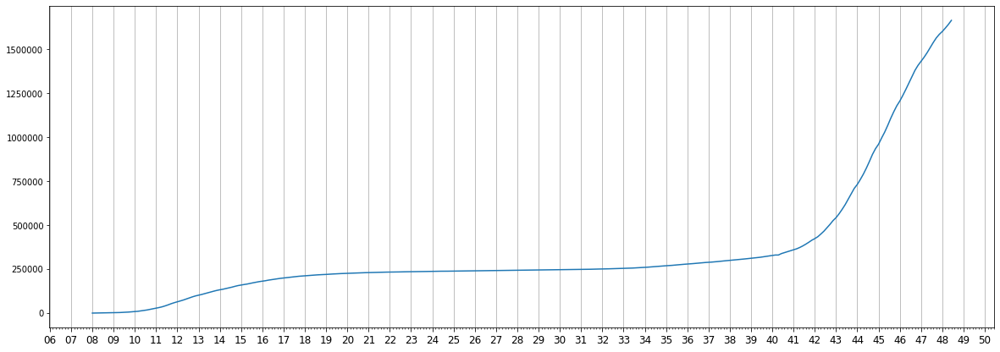

In [49]:
#plot data
fig, ax = plt.subplots(figsize=(20,7))
ax.xaxis.set_major_formatter(DateFormatter('%U'))
#ax.xaxis.set_minor_formatter(DateFormatter('%m-%d'))
#ax.xaxis.set_major_locator(mdates.WeekLocator())
ax.xaxis.set_major_locator(mdates.WeekdayLocator(byweekday=mdates.MO))
ax.xaxis.set_minor_locator(mdates.DayLocator())
ax.plot(df_covid_day['data'], df_covid_day[['totale_casi']])
#df_traffic.groupby(['week'])['DL_VOL'].sum()
# .plot(ax=ax)
# Rotate tick marks on x-axis

plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, fontsize=12)
plt.setp(ax.xaxis.get_minorticklabels(), rotation=70, fontsize=10)

ax.tick_params(axis = 'x', which='major', length=5)
ax.tick_params(axis = 'x', which='minor', length=2)

ax.xaxis.grid() # vertical lines
plt.show()

In [50]:
df_covid_daily.head(1)

,denominazione_regione,denominazione_provincia,sigla_provincia,data,totale_casi,casi_giornalieri
0,Abruzzo,Chieti,CH,2020-02-24,0,0.0


#### Covid - Temporal distribution - Daily

In [51]:
df_covid_daily_day = pd.DataFrame(df_covid_daily.groupby(df_covid_daily['data']).agg({
    'totale_casi': "sum", 'casi_giornalieri': 'sum'}).to_records())

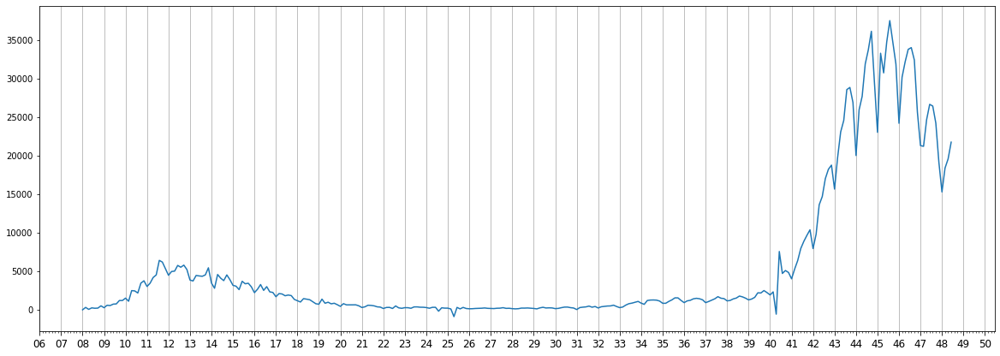

In [52]:

#plot data
fig, ax = plt.subplots(figsize=(20,7))
ax.xaxis.set_major_formatter(DateFormatter('%U'))
#ax.xaxis.set_minor_formatter(DateFormatter('%m-%d'))
#ax.xaxis.set_major_locator(mdates.WeekLocator())
ax.xaxis.set_major_locator(mdates.WeekdayLocator(byweekday=mdates.MO))
ax.xaxis.set_minor_locator(mdates.DayLocator())
ax.plot(df_covid_daily_day['data'], df_covid_daily_day['casi_giornalieri'])
#df_traffic.groupby(['week'])['DL_VOL'].sum()
# .plot(ax=ax)
# Rotate tick marks on x-axis

plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, fontsize=12)
plt.setp(ax.xaxis.get_minorticklabels(), rotation=70, fontsize=10)

ax.tick_params(axis = 'x', which='major', length=5)
ax.tick_params(axis = 'x', which='minor', length=2)

ax.xaxis.grid() # vertical lines
plt.show()